# A cellular taxonomy of the bone marrow stroma in homeostasis and leukemia

[Baryawno _et al._, 2019, Cell ](https://www-cell-com.kuleuven.ezproxy.kuleuven.be/cell/fulltext/S0092-8674(19)30459-3?_returnURL=https%3A%2F%2Flinkinghub.elsevier.com%2Fretrieve%2Fpii%2FS0092867419304593%3Fshowall%3Dtrue#secsectitle0255)

Here we will merge the bone and bone marrow stroma samples from the six individual mice into one full dataset. Then, we will subset the dataset to exclude cells from the hematopoietic lineage, as was done in the original publication.

In [1]:
library(Seurat)
library(ggplot2)
library(patchwork)

In [2]:
options(repr.plot.width = 15, repr.plot.height = 10)

### Loading the data

In [2]:
std1.data <- Read10X(data.dir = "RDataSessions/standards/standard1/")
std1 <- CreateSeuratObject(counts = std1.data, project = "Standard 1")

In [3]:
std2.data <- Read10X(data.dir = "RDataSessions/standards/standard2/")
std2 <- CreateSeuratObject(counts = std2.data, project = "Standard 2")

In [4]:
std3.data <- Read10X(data.dir = "RDataSessions/standards/standard3/")
std3 <- CreateSeuratObject(counts = std3.data, project = "Standard 3")

In [5]:
std4.data <- Read10X(data.dir = "RDataSessions/standards/standard4/")
std4 <- CreateSeuratObject(counts = std4.data, project = "Standard 4")

In [6]:
std5.data <- Read10X(data.dir = "RDataSessions/standards/standard5/")
std5 <- CreateSeuratObject(counts = std5.data, project = "Standard 5")

In [7]:
std6.data <- Read10X(data.dir = "RDataSessions/standards/standard6/")
std6 <- CreateSeuratObject(counts = std6.data, project = "Standard 6")

### Merging the `SeuratObjects`

In [8]:
standard <- merge(std1, y = c(std2, std3, std4, std5, std6), 
                  add.cell.ids = c("Std1", "Std2", "Std3", "Std4", "Std5", "Std6"),
                  project = "Standards")
standard

An object of class Seurat 
27998 features across 42000 samples within 1 assay 
Active assay: RNA (27998 features)

In [9]:
unique(sapply(X = strsplit(colnames(standard), split = "_"), FUN = "[", 1))

[1] "Std1" "Std2" "Std3" "Std4" "Std5" "Std6"

In [10]:
table(standard$orig.ident)


Standard 1 Standard 2 Standard 3 Standard 4 Standard 5 Standard 6 
      7000       7000       7000       7000       7000       7000 

## Standard pre-processing workflow

In [13]:
standard[["percent.mito"]] <- PercentageFeatureSet(standard, pattern = "^mt-")

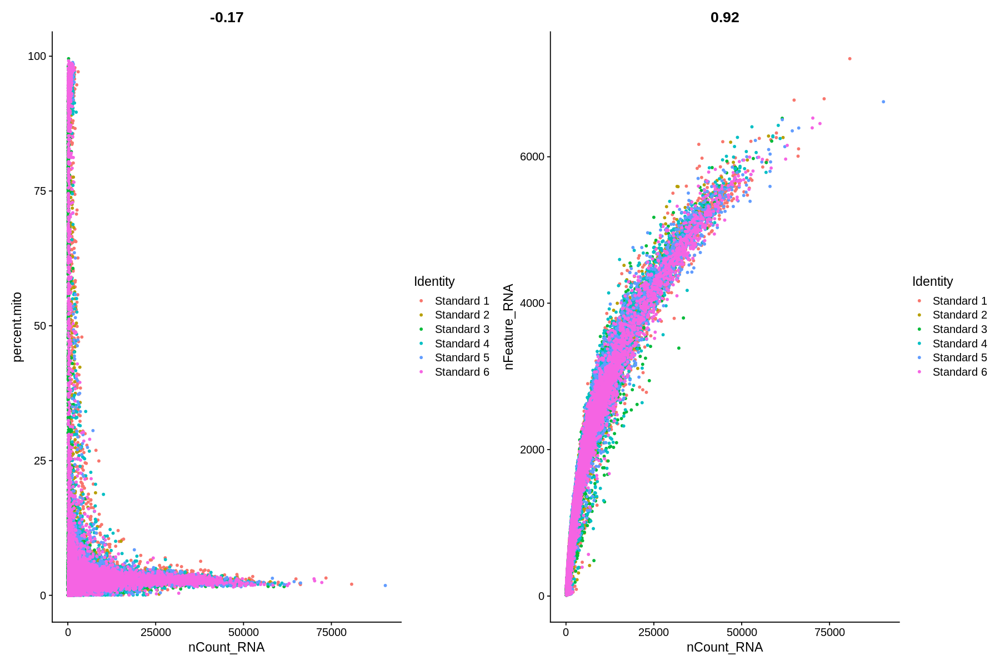

In [18]:
plot1 <- FeatureScatter(standard, feature1 = "nCount_RNA", feature2 = "percent.mito")
plot2 <- FeatureScatter(standard, feature1 = "nCount_RNA", feature2 = "nFeature_RNA")

plot1 + plot2

In [22]:
# percent.mito cut-off
mean(standard@meta.data$percent.mito) + 0.5*sd(standard@meta.data$percent.mito)

[1] 16.40748

In [24]:
standard <- subset(standard, subset = nFeature_RNA > 500 & percent.mito < 16.4)
standard

An object of class Seurat 
27998 features across 35818 samples within 1 assay 
Active assay: RNA (27998 features)

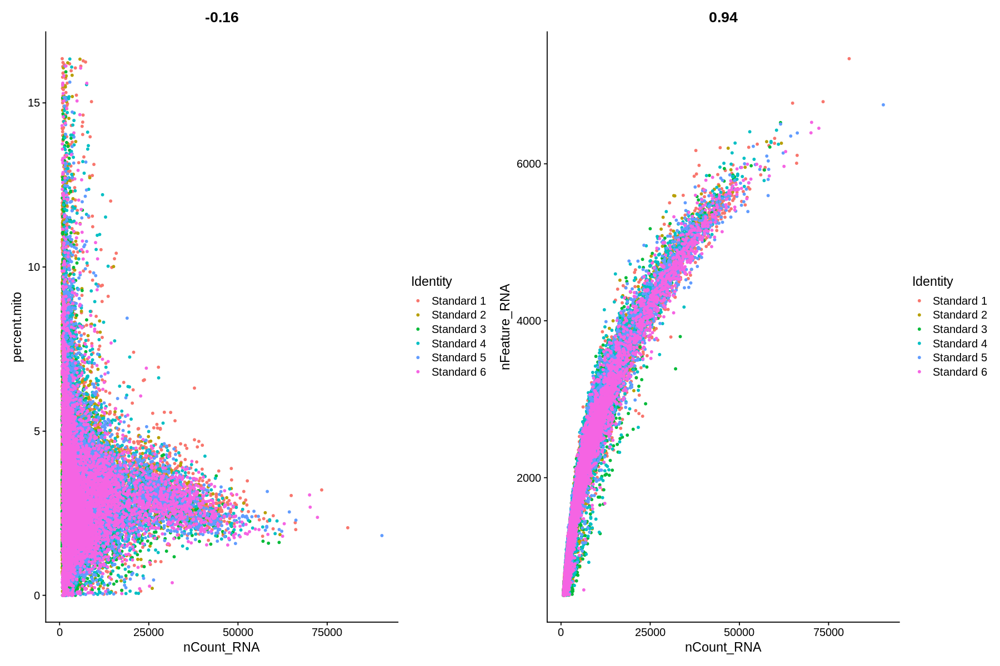

In [25]:
plot1 <- FeatureScatter(standard, feature1 = "nCount_RNA", feature2 = "percent.mito")
plot2 <- FeatureScatter(standard, feature1 = "nCount_RNA", feature2 = "nFeature_RNA")

plot1 + plot2

## Normalisation

In [26]:
standard <- NormalizeData(standard, normalization.method = "LogNormalize", scale.factor = 10000)

## Feature selection

In [27]:
standard <- FindVariableFeatures(standard, selection.method = "vst", nfeatures = 2000)

## Scaling

In [28]:
hvgs <- VariableFeatures(standard)
length(hvgs)

[1] 2000

In [29]:
standard <- ScaleData(standard, features = hvgs)

Centering and scaling data matrix



### Linear dimensionality reduction: PCA

In [32]:
standard <- RunPCA(standard, features = hvgs, verbose = FALSE)

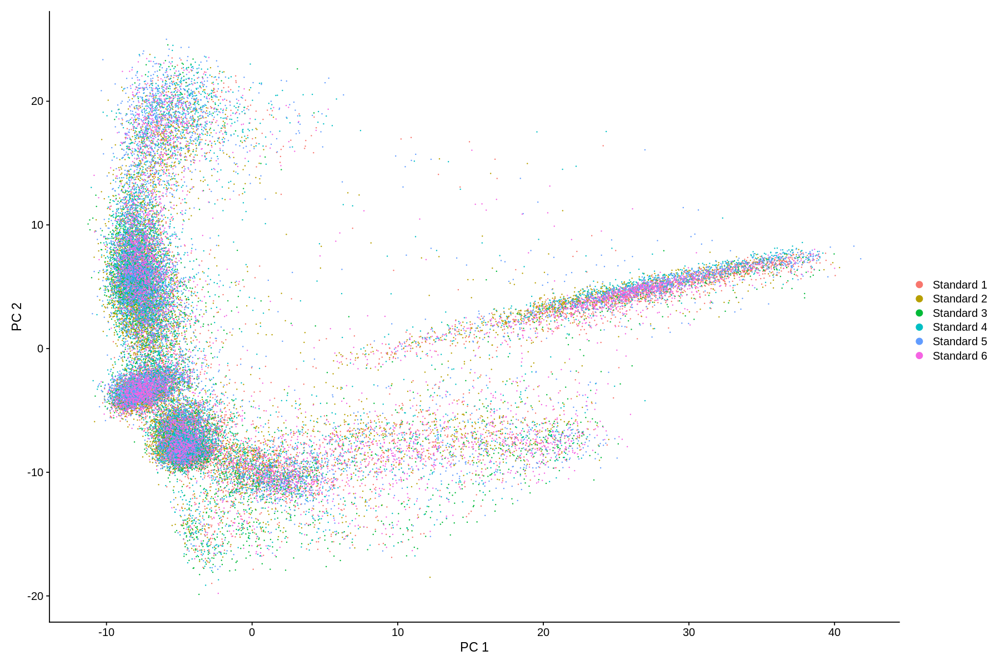

In [34]:
DimPlot(standard, reduction = "pca") + xlab("PC 1") + ylab("PC 2")

## Clustering

In [43]:
standard <- FindNeighbors(standard, dims = 1:50)
standard <- FindClusters(standard, resolution = 0.75)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 35818
Number of edges: 1356040

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9319
Number of communities: 28
Elapsed time: 5 seconds


In [44]:
standard <- RunTSNE(standard, dims = 1:50)
standard <- RunUMAP(standard, dims = 1:50)

03:10:27 UMAP embedding parameters a = 0.9922 b = 1.112

03:10:27 Read 35818 rows and found 50 numeric columns

03:10:27 Using Annoy for neighbor search, n_neighbors = 30

03:10:27 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*

|

03:10:33 Writing NN index file to temp file /tmp/RtmpMORCZ1/file49b1368c0498

03:10:33 Searching Annoy index using 1 thread, search_k = 3000

03:10:44 Annoy recall = 100%

03:10:44 Commencing smooth kNN distance calibration using 1 thread

03:10:45 Initializing from normalized Laplacian + noise

03:10:48 Commencing optimization for 200 epochs, with 1558168 positive edges

03:11:18 Optimization finished



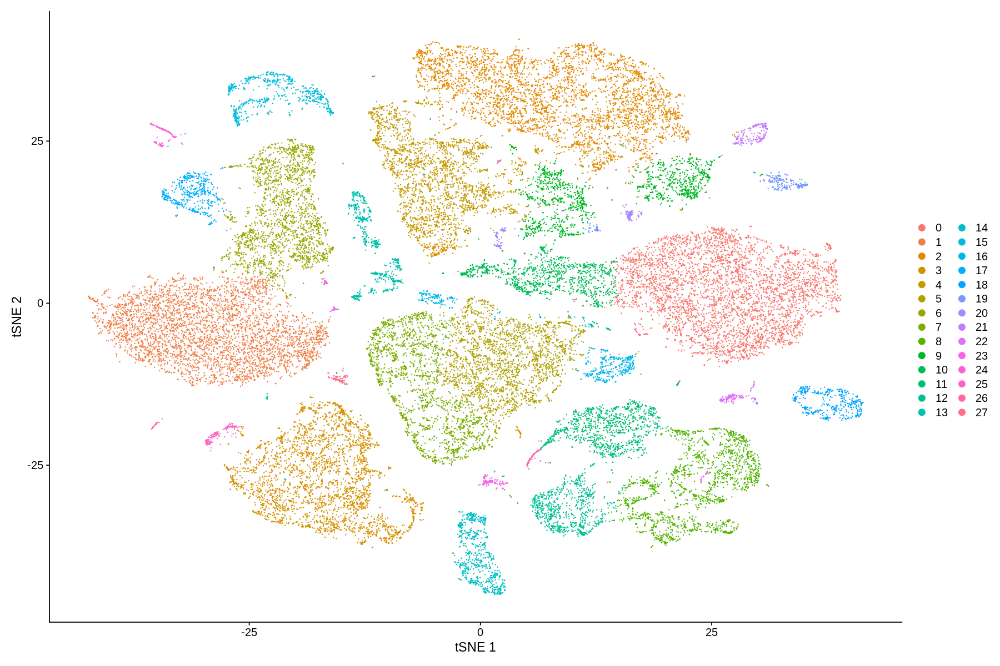

In [45]:
DimPlot(standard, reduction = "tsne") + xlab("tSNE 1") + ylab("tSNE 2")

Warning message:
“Using `as.character()` on a quosure is deprecated as of rlang 0.3.0.
Please use `as_label()` or `as_name()` instead.
This warning is displayed once per session.”


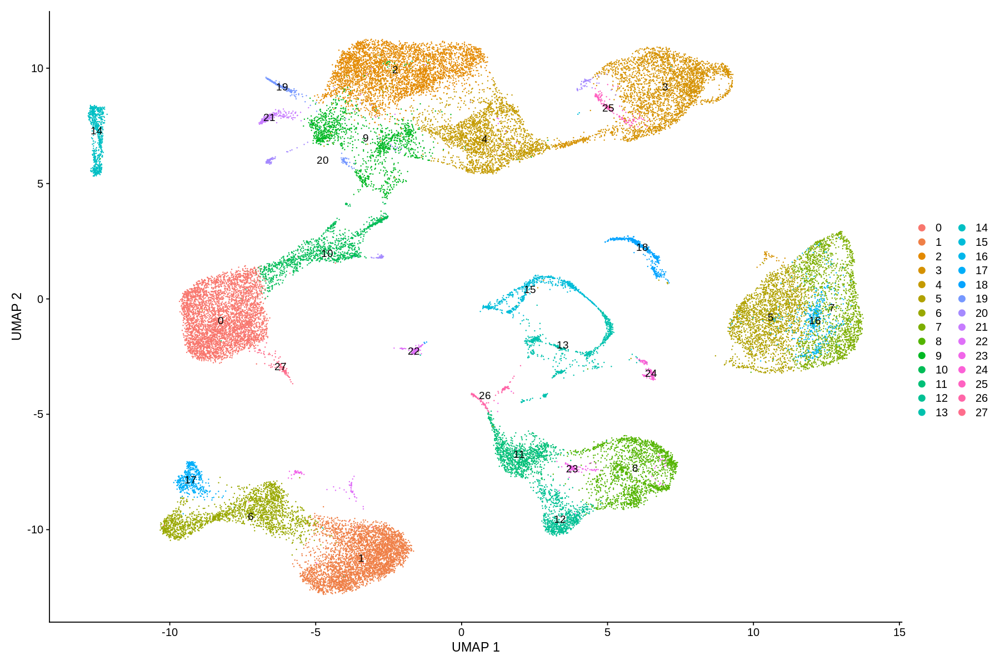

In [47]:
DimPlot(standard, reduction = "umap", label = TRUE) + xlab("UMAP 1") + ylab("UMAP 2")

### B-cells

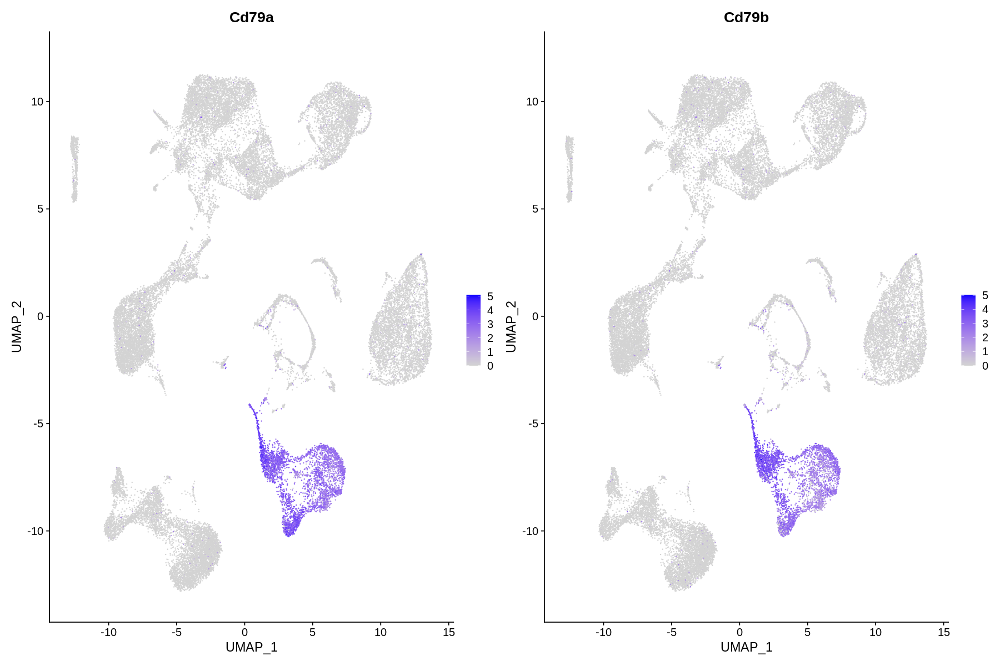

In [52]:
FeaturePlot(standard, features = c("Cd79a", "Cd79b"))

### Granulocytes

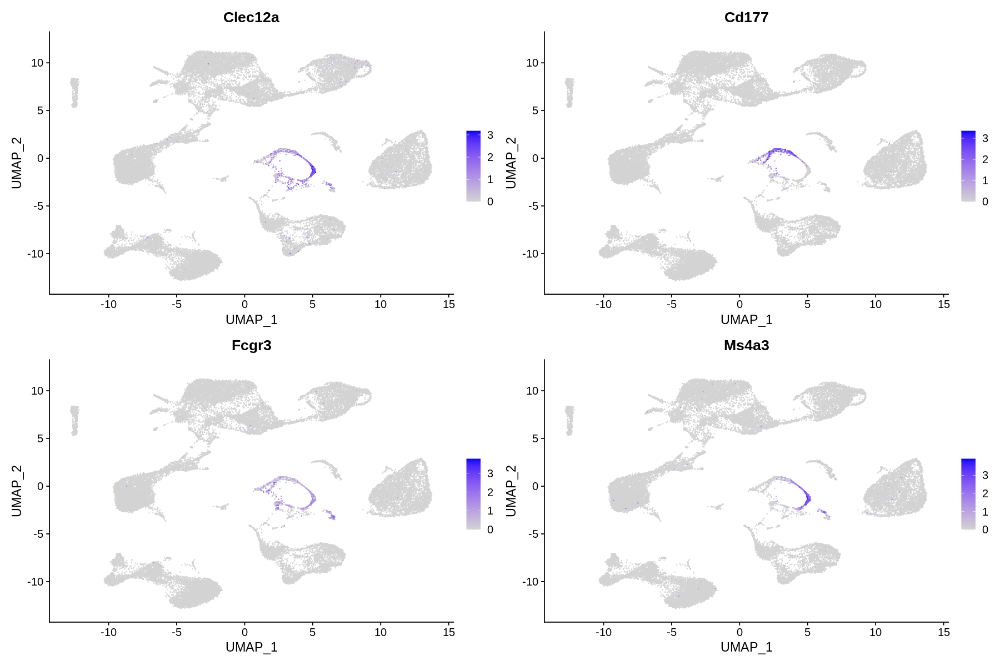

In [91]:
FeaturePlot(standard, features = c("Clec12a", "Cd177", "Fcgr3", "Ms4a3")) # Cd371, Cd32a, Cd20l

### Granulocytes + B-cells

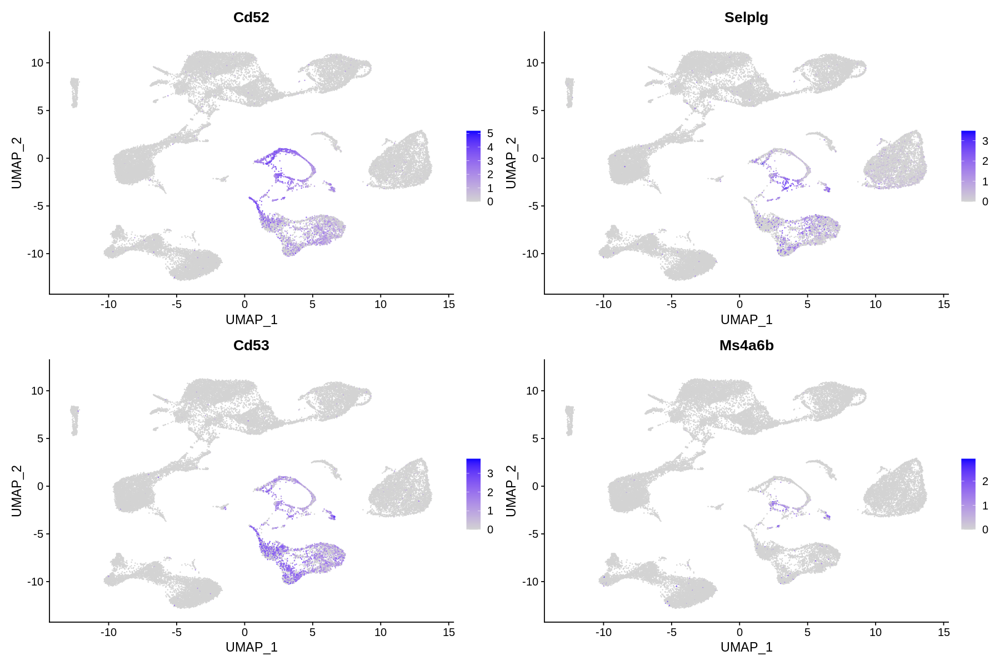

In [81]:
FeaturePlot(standard, features = c("Cd52", "Selplg", "Cd53")) # Cd162,

### Erythrocytes

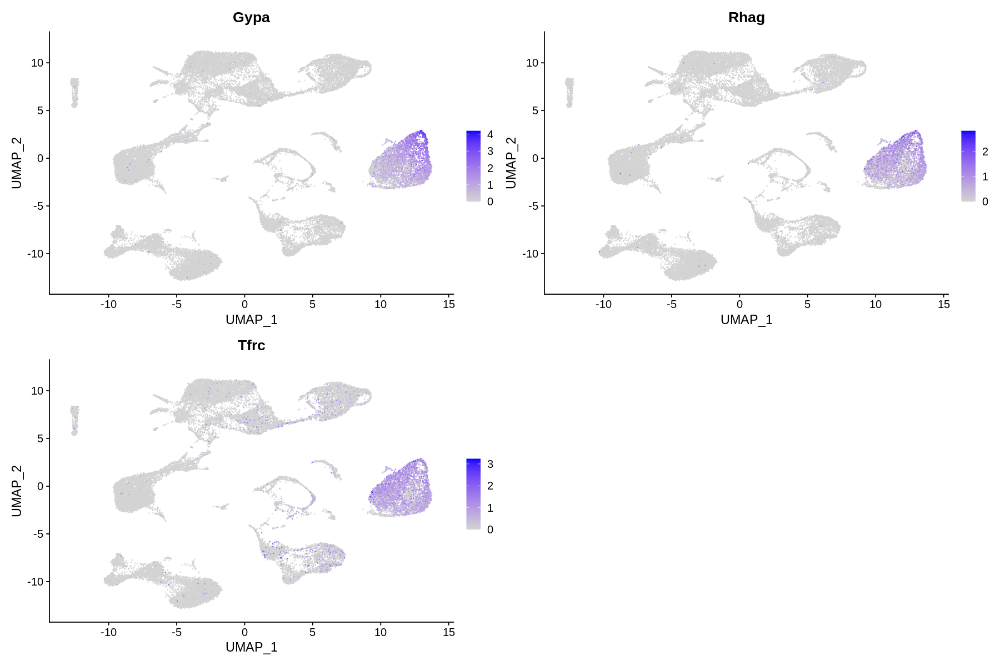

In [64]:
FeaturePlot(standard, features = c("Gypa", "Rhag", "Tfrc")) # Cd235a, Cd241, Cd71

### Macrophages

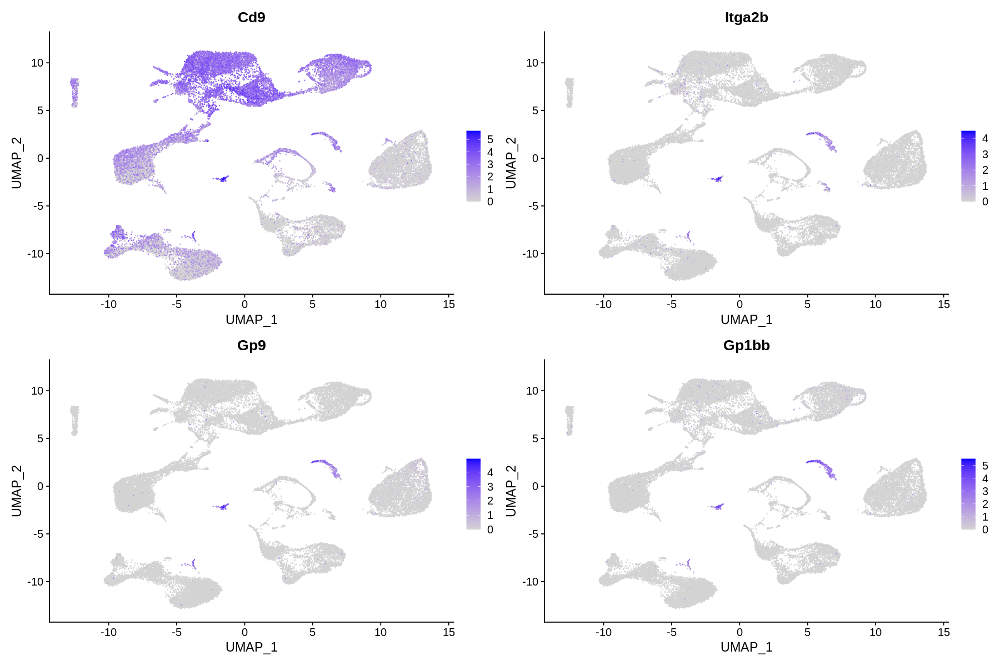

In [85]:
FeaturePlot(standard, features = c("Cd9", "Itga2b", "Gp9", "Gp1bb"))

### Endothelium

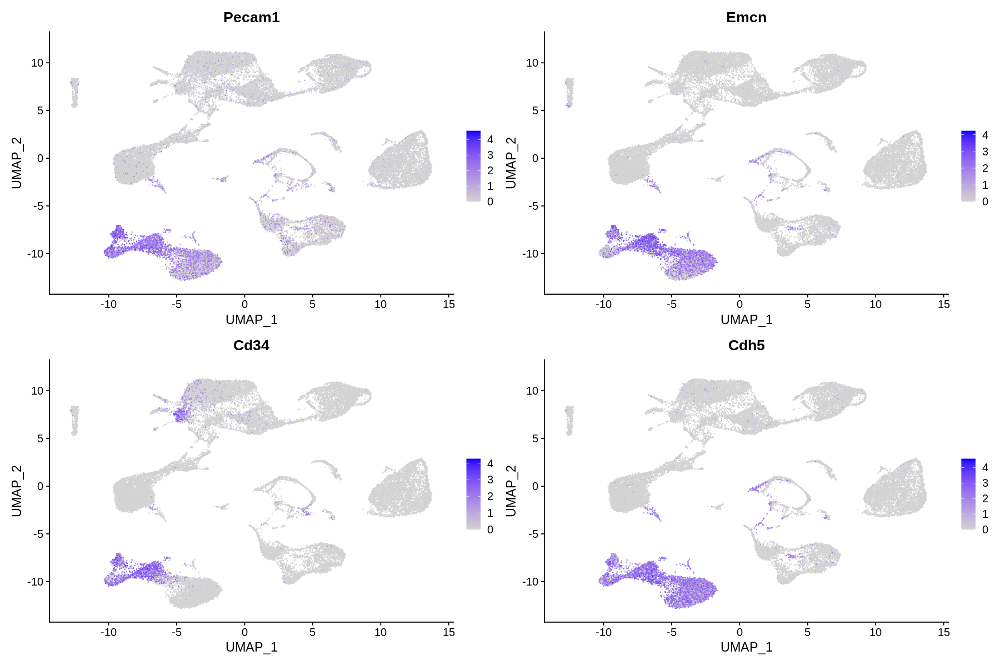

In [108]:
FeaturePlot(standard, features = c("Pecam1", "Emcn", "Cd34", "Cdh5"))

### Osteoblasts

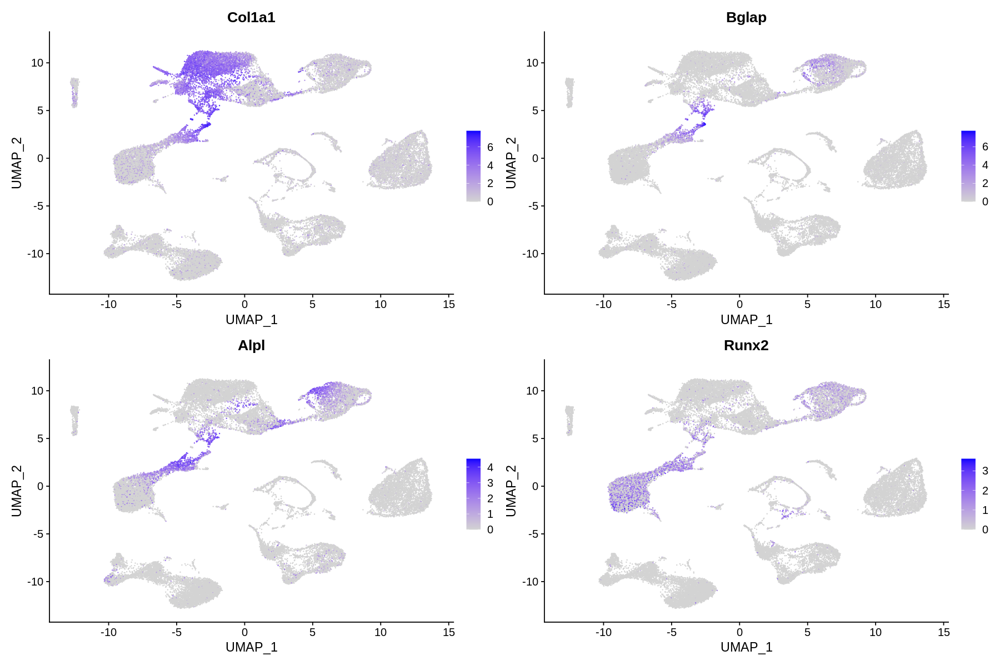

In [110]:
FeaturePlot(standard, features = c("Col1a1", "Bglap", "Alpl", "Runx2"))

### BM-MSC

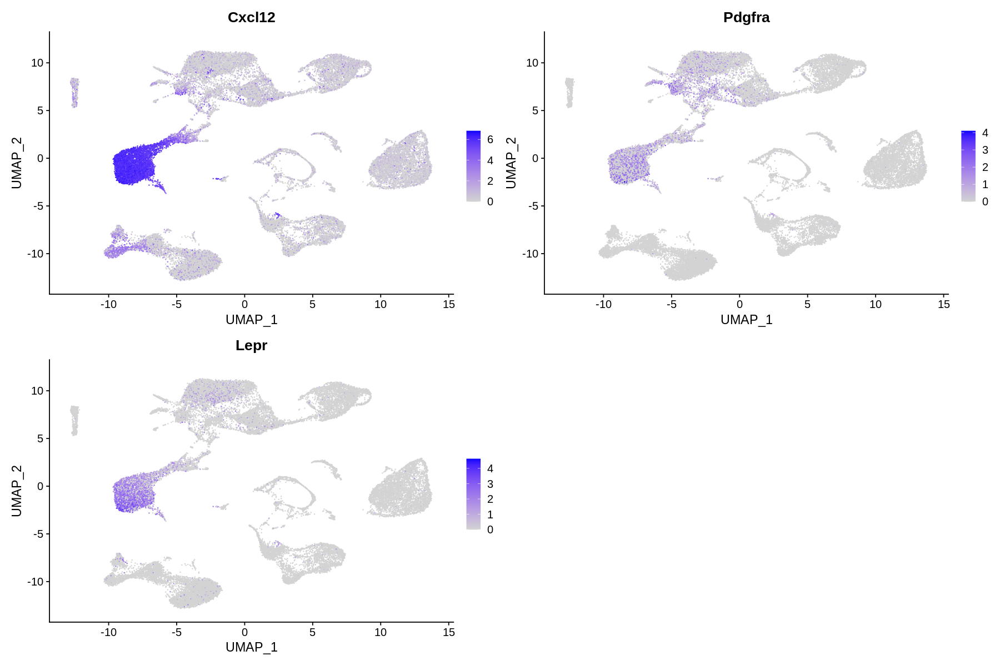

In [112]:
FeaturePlot(standard, features = c("Cxcl12", "Pdgfra", "Lepr"))

### Cartilage

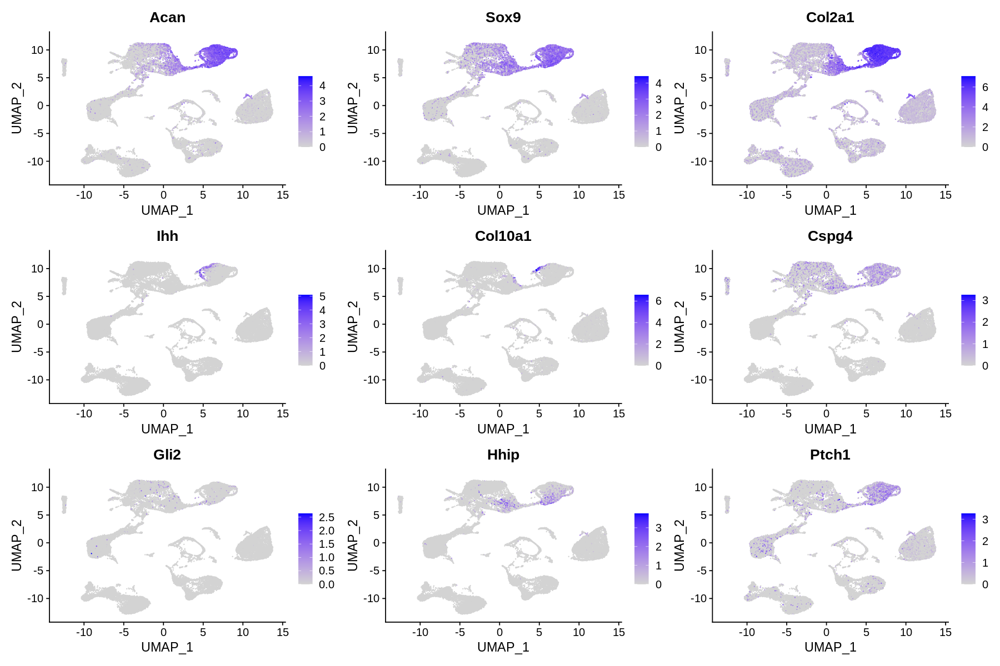

In [109]:
FeaturePlot(standard,features = c("Acan", "Sox9", "Col2a1", "Ihh", "Col10a1", "Cspg4", "Gli2", "Hhip", "Ptch1"))

### Fibrous tissue

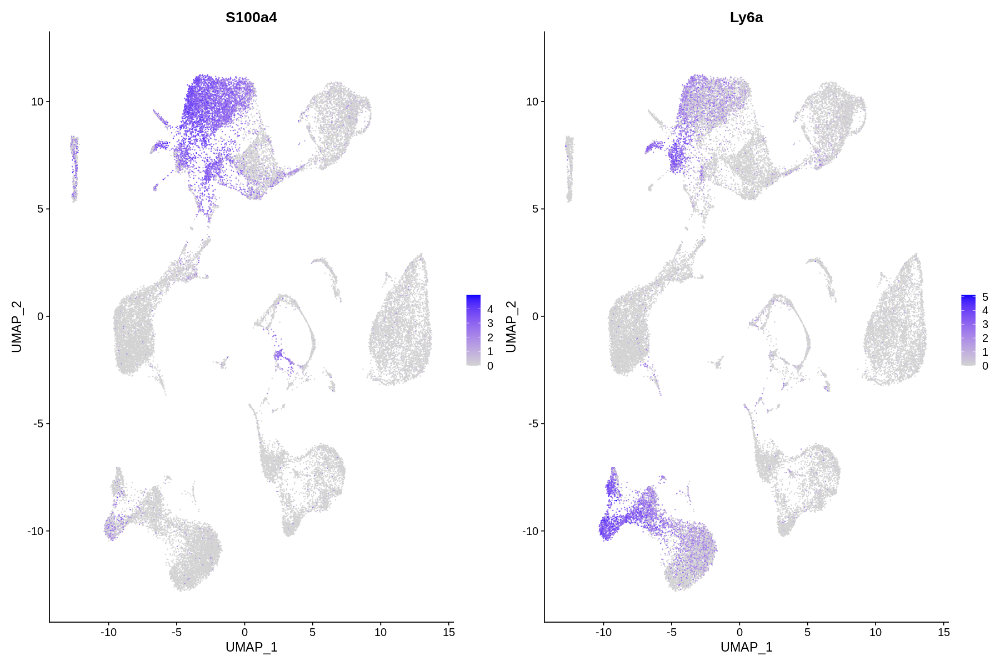

In [113]:
FeaturePlot(standard, features = c("S100a4", "Ly6a"))

## Removing hematopoietic lineage

In [123]:
hemato.idents <- as.factor(c(5, 7, 8, 11, 12, 13, 15, 16, 18, 22, 23, 24, 26))
nonhemato.barcodes <- rownames(standard@meta.data[!(standard@meta.data$seurat_clusters %in% hemato.idents),])
length(nonhemato.barcodes)

[1] 24899

In [192]:
bms <- subset(standard, cells = nonhemato.barcodes)
bms

An object of class Seurat 
27998 features across 24899 samples within 1 assay 
Active assay: RNA (27998 features)
 3 dimensional reductions calculated: pca, tsne, umap

## Re-scaling

In [193]:
hvgs <- VariableFeatures(bms)
length(hvgs)

[1] 2000

In [194]:
bms <- ScaleData(bms, features = hvgs)

Centering and scaling data matrix



### Linear dimensionality reduction: PCA

In [195]:
bms <- RunPCA(bms, features = hvgs, verbose = FALSE)

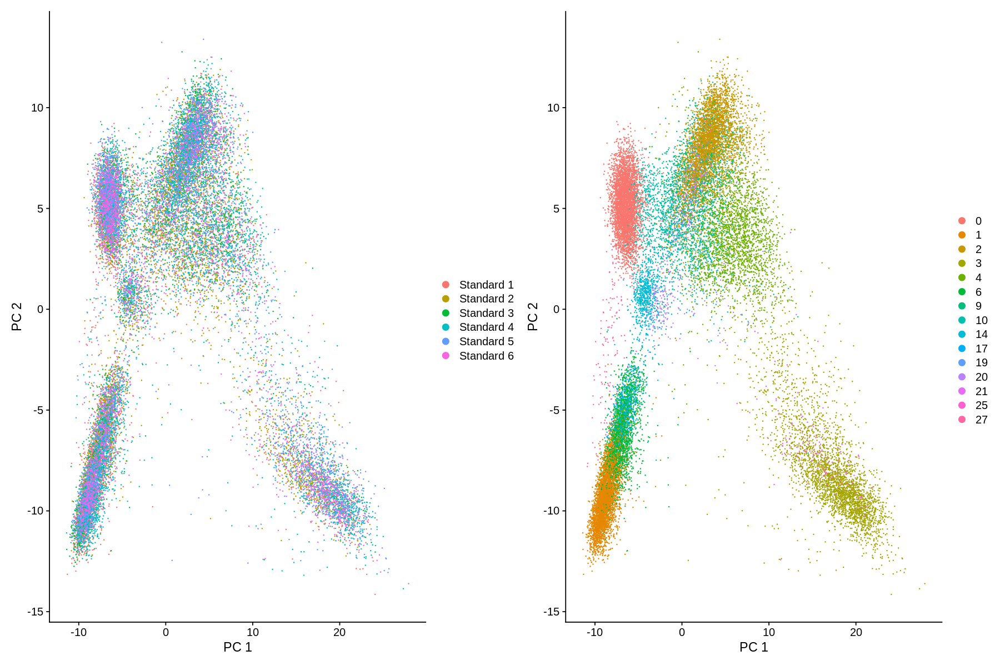

In [196]:
p1 <- DimPlot(bms, reduction = "pca", group.by = "orig.ident") + xlab("PC 1") + ylab("PC 2")
p2 <- DimPlot(bms, reduction = "pca", group.by = "seurat_clusters") + xlab("PC 1") + ylab("PC 2")

p1 + p2

## Clustering

In [215]:
bms <- FindNeighbors(bms, dims = 1:50)
bms <- FindClusters(bms, resolution = 0.35)

Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 24899
Number of edges: 980941

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9438
Number of communities: 18
Elapsed time: 3 seconds


In [216]:
bms <- RunTSNE(bms, dims = 1:30)
bms <- RunUMAP(bms, dims = 1:30)

23:20:46 UMAP embedding parameters a = 0.9922 b = 1.112

23:20:46 Read 24899 rows and found 30 numeric columns

23:20:46 Using Annoy for neighbor search, n_neighbors = 30

23:20:46 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*

|

23:20:50 Writing NN index file to temp file /tmp/RtmpMORCZ1/file49b1390e0f00

23:20:50 Searching Annoy index using 1 thread, search_k = 3000

23:20:57 Annoy recall = 100%

23:20:57 Commencing smooth kNN distance calibration using 1 thread

23:20:58 Initializing from normalized Laplacian + noise

23:21:00 Commencing optimization for 200 epochs, with 1076948 positive edges

23:21:21 Optimization finished



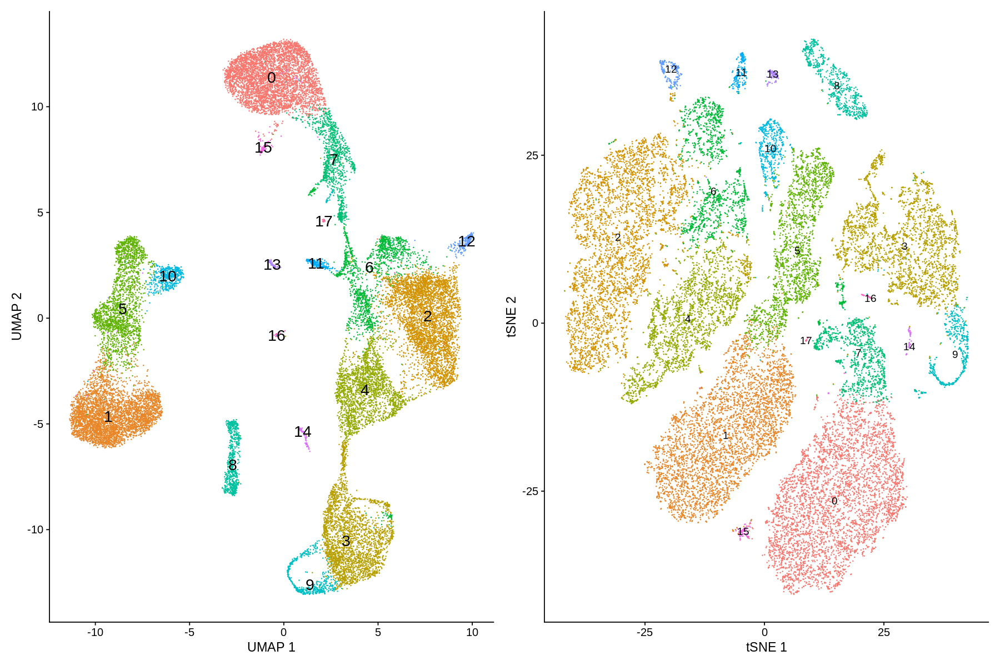

In [223]:
p1 <- DimPlot(bms, label = TRUE, label.size = 6) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- DimPlot(bms, reduction = "tsne", label = TRUE) + NoLegend() + xlab("tSNE 1") + ylab("tSNE 2")
p1 + p2

## Annotation

### Marker genes

In [203]:
markers <- FindAllMarkers(bms, logfc.threshold = 0.25, features = hvgs, only.pos = TRUE)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14

Calculating cluster 15

Calculating cluster 16

Calculating cluster 17



### Pericytes

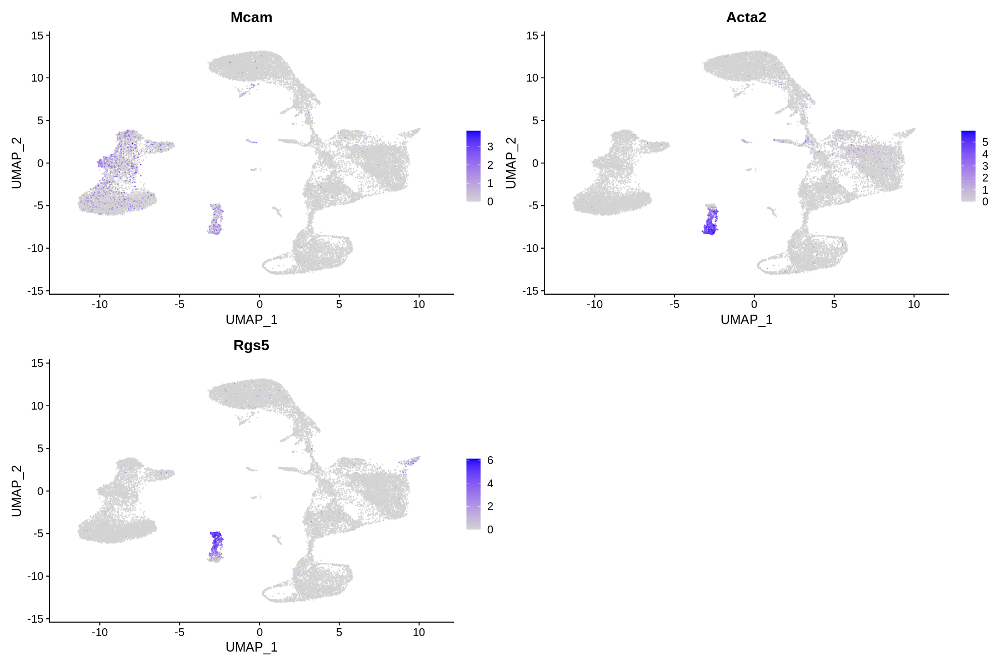

In [224]:
FeaturePlot(bms, reduction = "umap", features = c("Mcam", "Acta2", "Rgs5")) # Mcam = Cd146

### LepR+ BM-MSCs

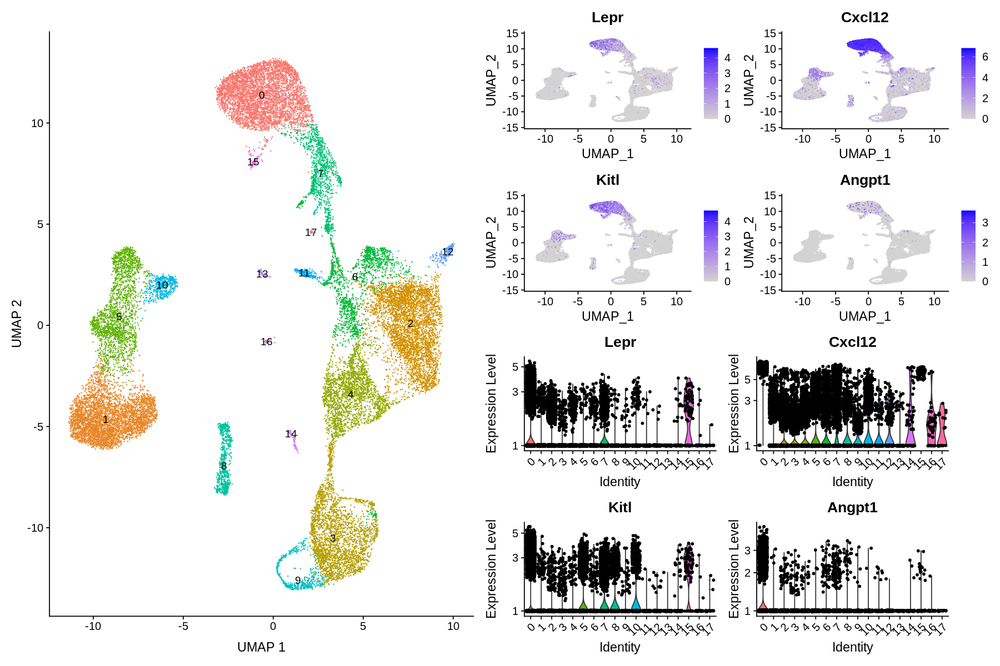

In [225]:
p1 <- FeaturePlot(bms, features = c("Lepr", "Cxcl12", "Kitl", "Angpt1"))
p2 <- VlnPlot(bms, features = c("Lepr", "Cxcl12", "Kitl", "Angpt1"), ncol = 2, log = TRUE)
p3 <- DimPlot(bms, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")

p3 + p1/p2

### Chondrogenic lineage

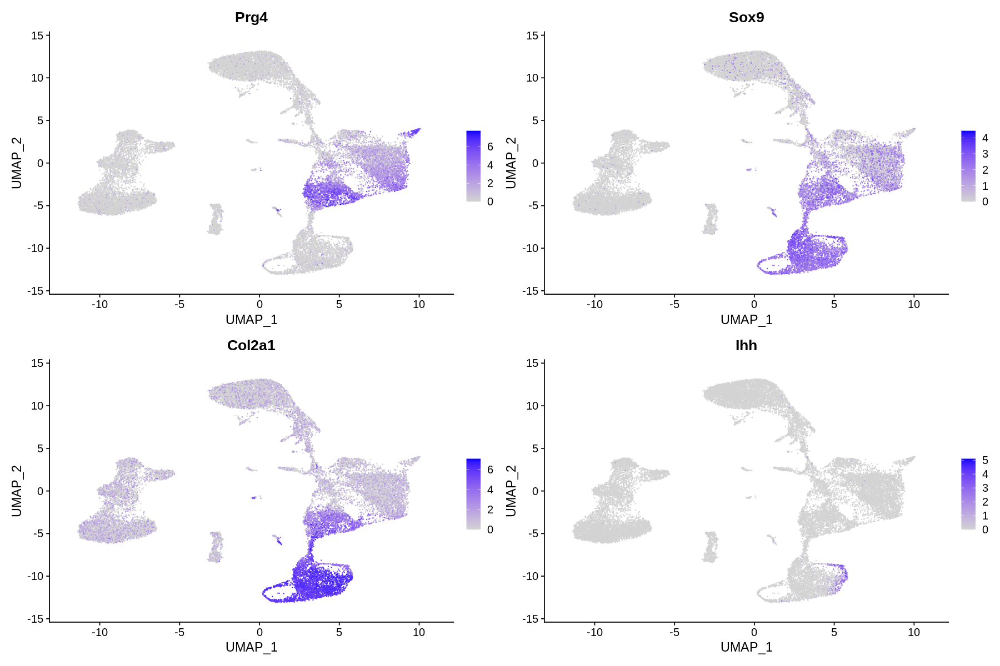

In [237]:
FeaturePlot(bms, features = c("Prg4", "Sox9", "Col2a1", "Ihh"))

### Osteogenic lineage

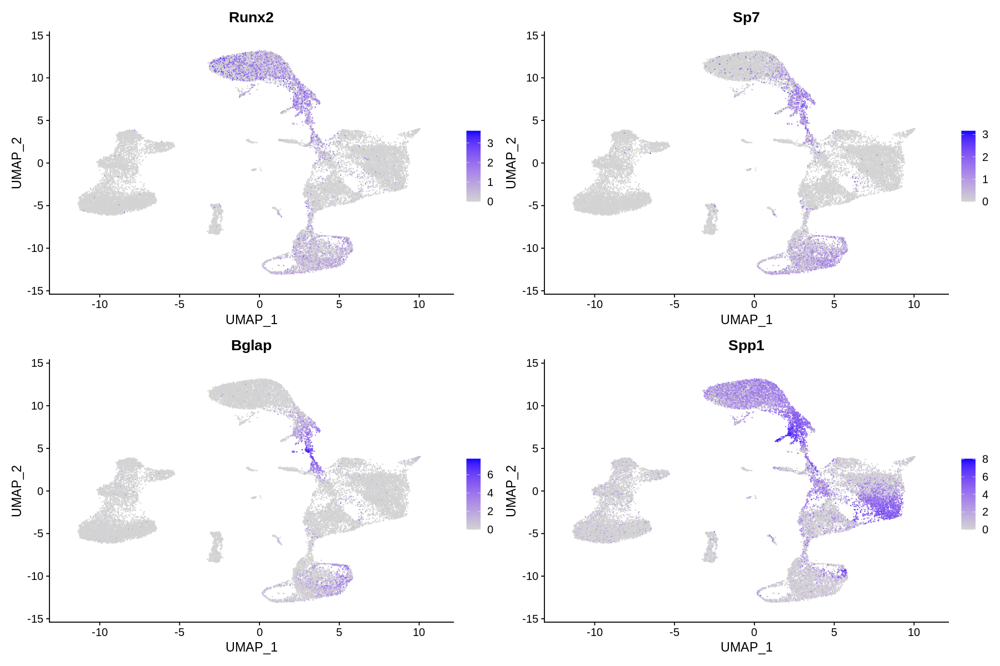

In [227]:
FeaturePlot(bms, features = c("Runx2", "Sp7", "Bglap", "Spp1"))

### Osteocytes

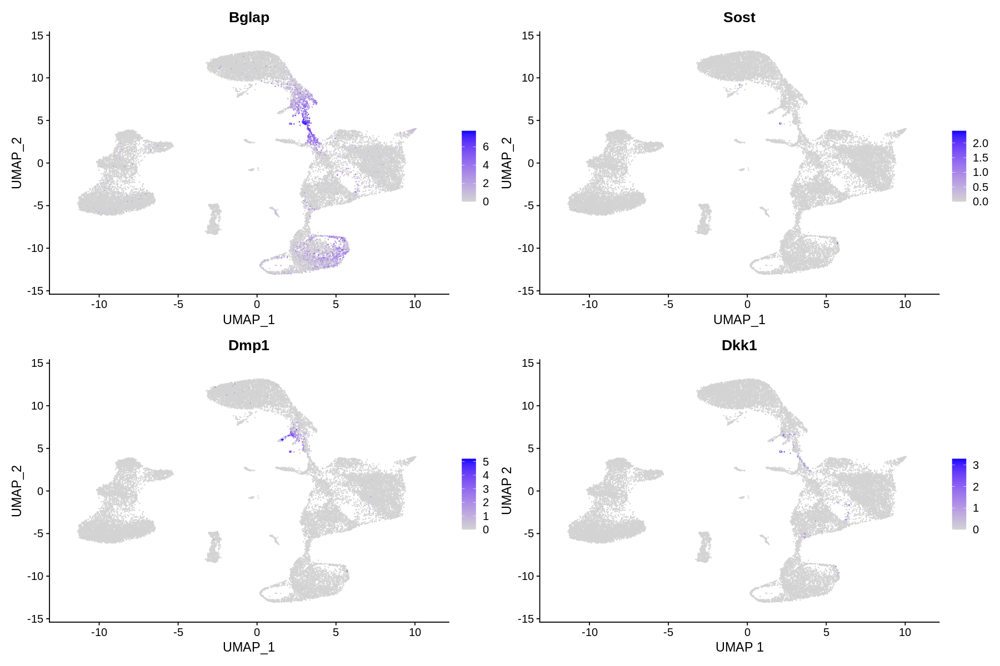

In [232]:
FeaturePlot(bms, features = c("Bglap", "Sost", "Dmp1", "Dkk1")) + xlab("UMAP 1") + ylab("UMAP 2")

### Endothelium

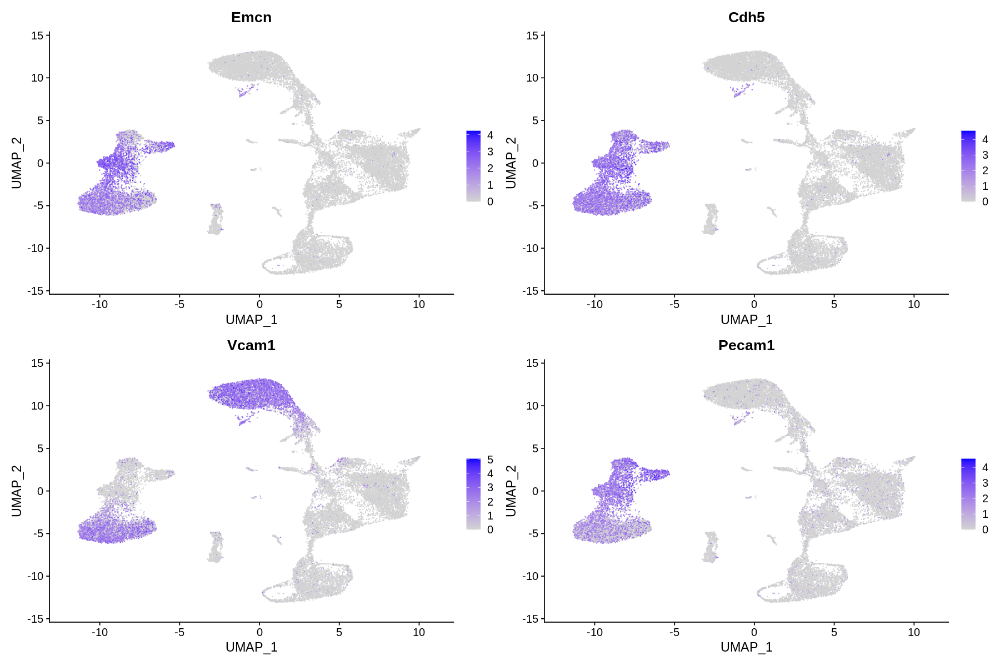

In [236]:
FeaturePlot(bms, features = c("Emcn", "Cdh5", "Vcam1", "Pecam1"))

### Fibroblasts

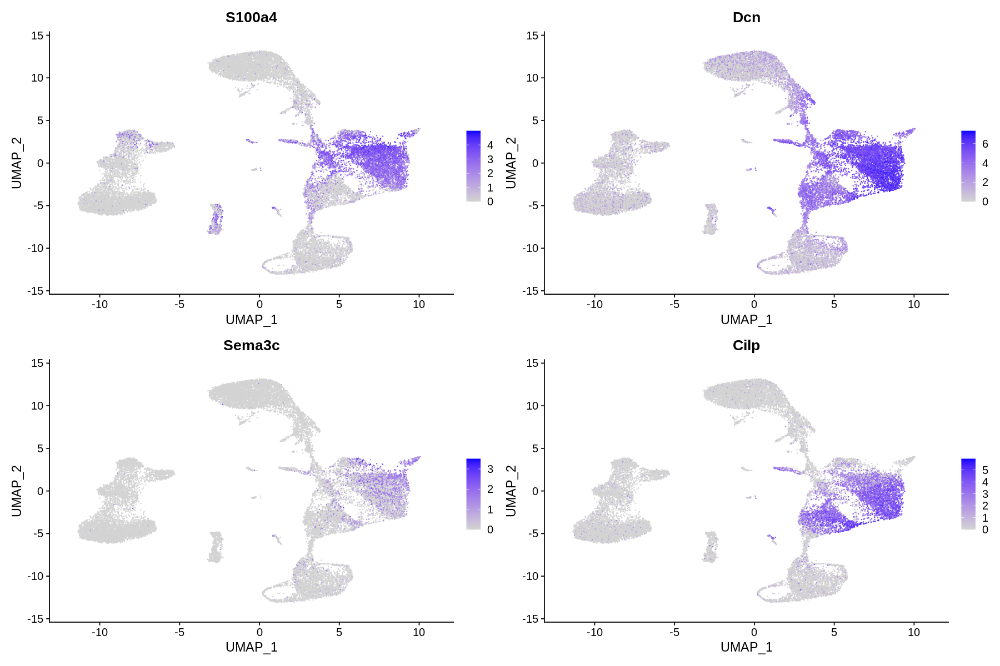

In [242]:
FeaturePlot(bms, features = c("S100a4", "Dcn", "Sema3c", "Cilp"))

## Removing remnants of hematopoietic lineage

In [253]:
hemato.idents <- as.factor(c(13, 14, 16))
nonhemato.barcodes <- rownames(bms@meta.data[!(bms@meta.data$seurat_clusters %in% hemato.idents),])
length(nonhemato.barcodes)

[1] 24652

In [254]:
bm <- subset(standard, cells = nonhemato.barcodes)
bm

An object of class Seurat 
27998 features across 24652 samples within 1 assay 
Active assay: RNA (27998 features)
 3 dimensional reductions calculated: pca, tsne, umap

## Re-scaling

In [255]:
hvgs <- VariableFeatures(bm)
length(hvgs)

[1] 2000

In [256]:
bm <- ScaleData(bm, features = hvgs)

Centering and scaling data matrix



### Linear dimensionality reduction: PCA

In [257]:
bm <- RunPCA(bm, features = hvgs, verbose = FALSE)

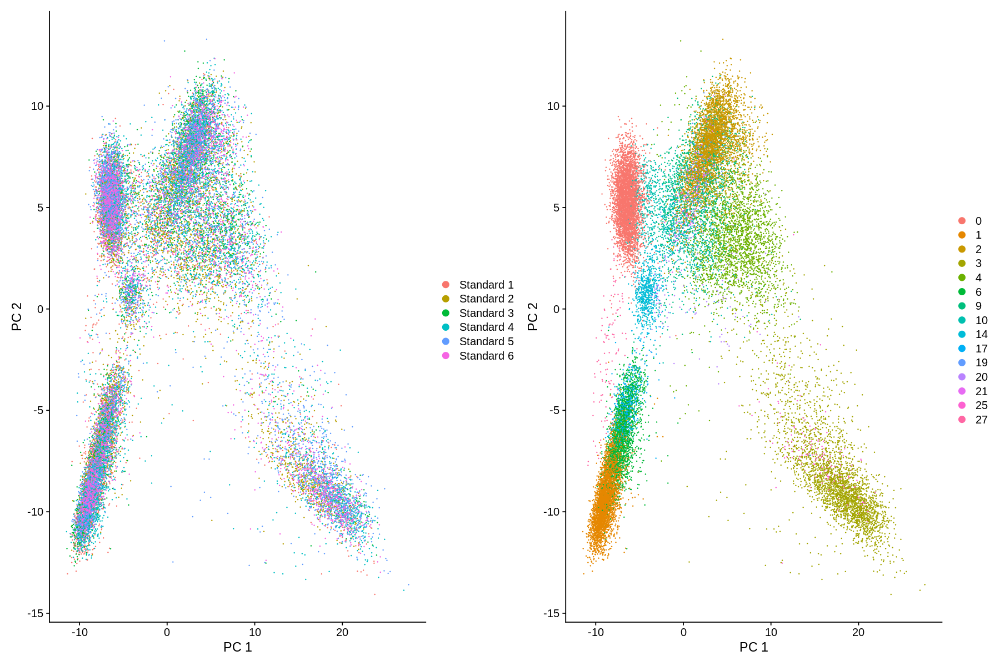

In [258]:
p1 <- DimPlot(bm, reduction = "pca", group.by = "orig.ident") + xlab("PC 1") + ylab("PC 2")
p2 <- DimPlot(bm, reduction = "pca", group.by = "seurat_clusters") + xlab("PC 1") + ylab("PC 2")

p1 + p2

## Clustering

In [259]:
bm <- FindNeighbors(bm, dims = 1:50)
bm <- FindClusters(bm, resolution = 0.35)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 24652
Number of edges: 967976

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9432
Number of communities: 15
Elapsed time: 3 seconds


In [216]:
bm <- RunTSNE(bm, dims = 1:30)
bm <- RunUMAP(bm, dims = 1:30)

23:20:46 UMAP embedding parameters a = 0.9922 b = 1.112

23:20:46 Read 24899 rows and found 30 numeric columns

23:20:46 Using Annoy for neighbor search, n_neighbors = 30

23:20:46 Building Annoy index with metric = cosine, n_trees = 50

0%   10   20   30   40   50   60   70   80   90   100%

[----|----|----|----|----|----|----|----|----|----|

*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*
*

|

23:20:50 Writing NN index file to temp file /tmp/RtmpMORCZ1/file49b1390e0f00

23:20:50 Searching Annoy index using 1 thread, search_k = 3000

23:20:57 Annoy recall = 100%

23:20:57 Commencing smooth kNN distance calibration using 1 thread

23:20:58 Initializing from normalized Laplacian + noise

23:21:00 Commencing optimization for 200 epochs, with 1076948 positive edges

23:21:21 Optimization finished



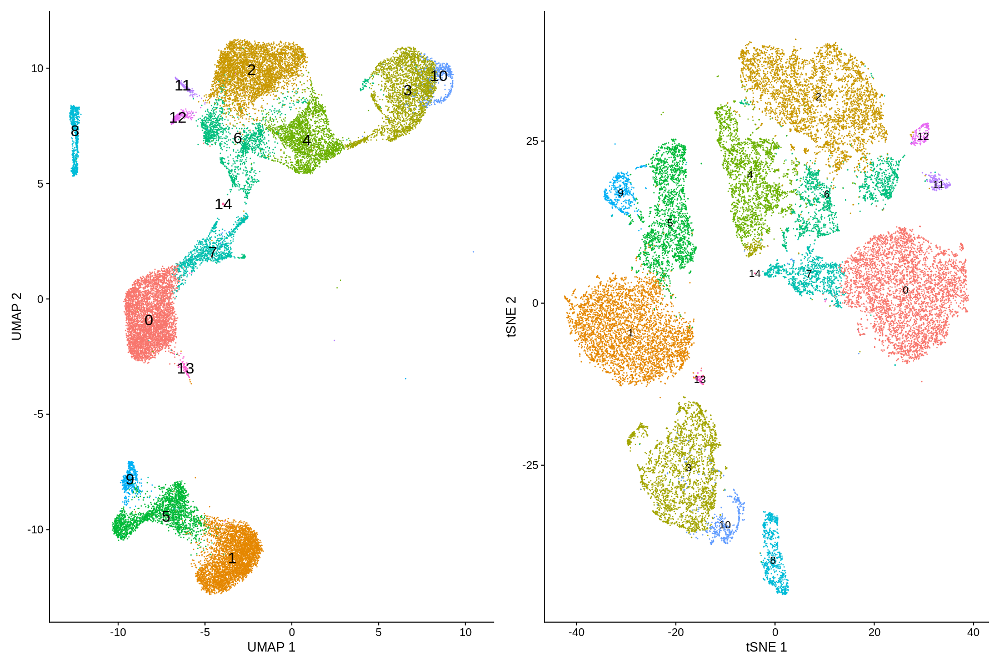

In [260]:
p1 <- DimPlot(bm, label = TRUE, label.size = 6) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- DimPlot(bm, reduction = "tsne", label = TRUE) + NoLegend() + xlab("tSNE 1") + ylab("tSNE 2")
p1 + p2

## Annotation

### Marker genes

In [261]:
markers <- FindAllMarkers(bm, logfc.threshold = 0.25, features = hvgs, only.pos = TRUE)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11

Calculating cluster 12

Calculating cluster 13

Calculating cluster 14



### Pericytes

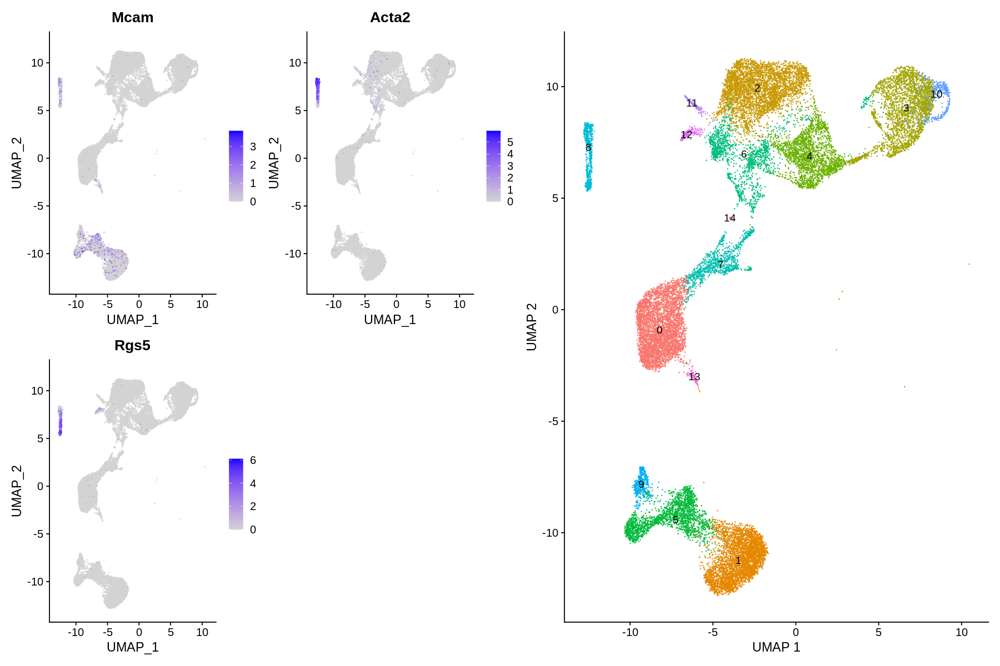

In [273]:
p1 <- FeaturePlot(bm, reduction = "umap", features = c("Mcam", "Acta2", "Rgs5")) # Mcam = Cd146
p2 <- DimPlot(bm, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")

p1 | p2

### LepR+ BM-MSCs

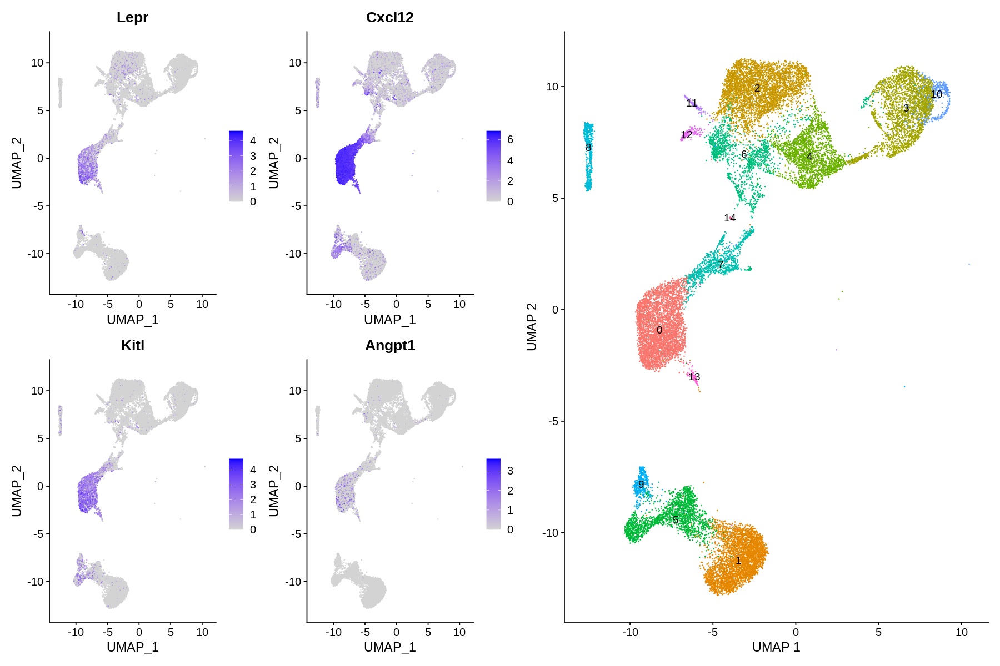

In [269]:
p1 <- FeaturePlot(bm, features = c("Lepr", "Cxcl12", "Kitl", "Angpt1"))
p2 <- DimPlot(bm, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")

p1 | p2

### Chondrogenic lineage

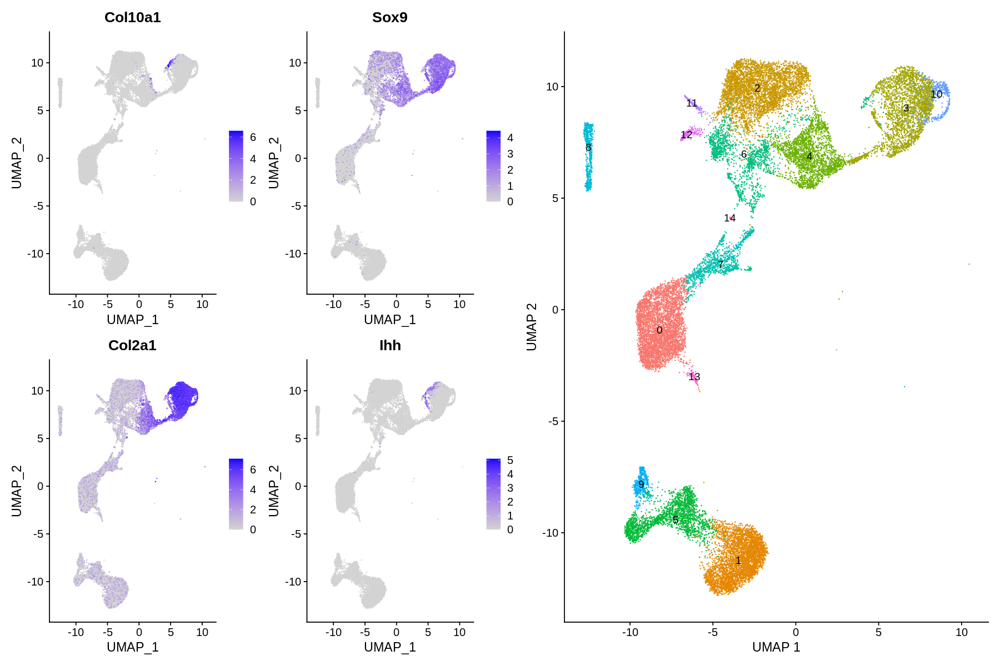

In [274]:
p1 <- FeaturePlot(bm, features = c("Col10a1", "Sox9", "Col2a1", "Ihh"))
p2 <- DimPlot(bm, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")

p1 | p2

### Osteogenic lineage

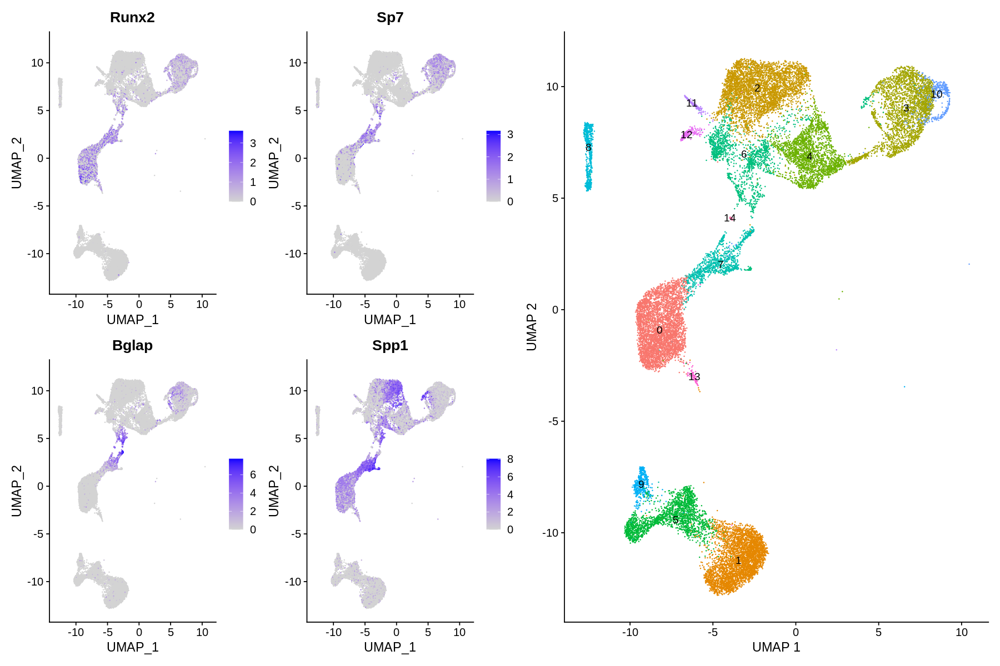

In [276]:
p1 <- FeaturePlot(bm, features = c("Runx2", "Sp7", "Bglap", "Spp1"))
p2 <- DimPlot(bm, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")

p1 | p2

### Osteocytes

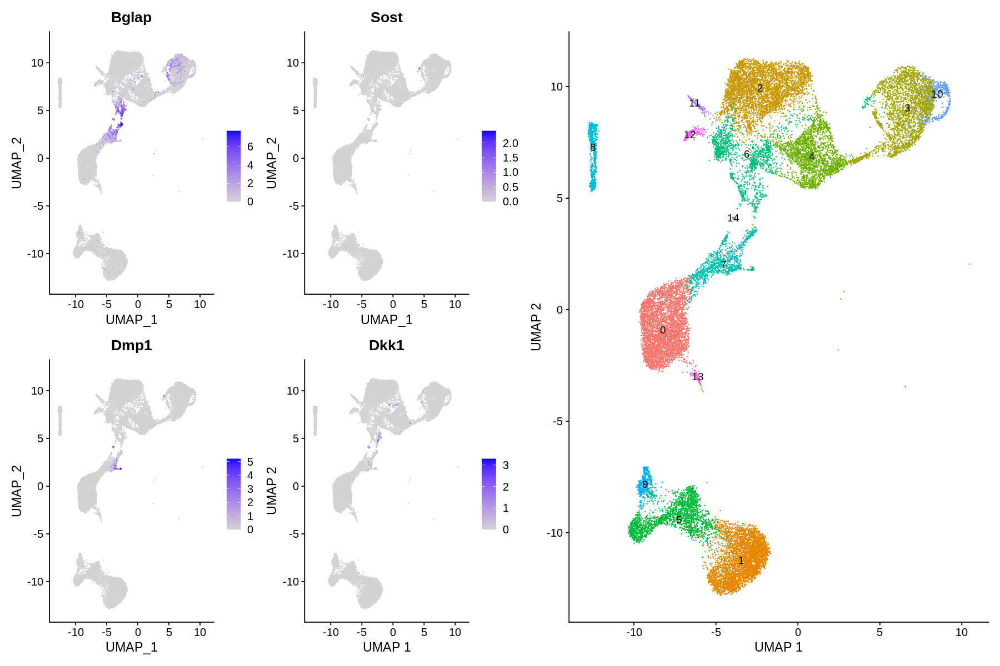

In [279]:
p1 <- FeaturePlot(bm, features = c("Bglap", "Sost", "Dmp1", "Dkk1")) + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- DimPlot(bm, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")

p1 | p2

### Endothelium

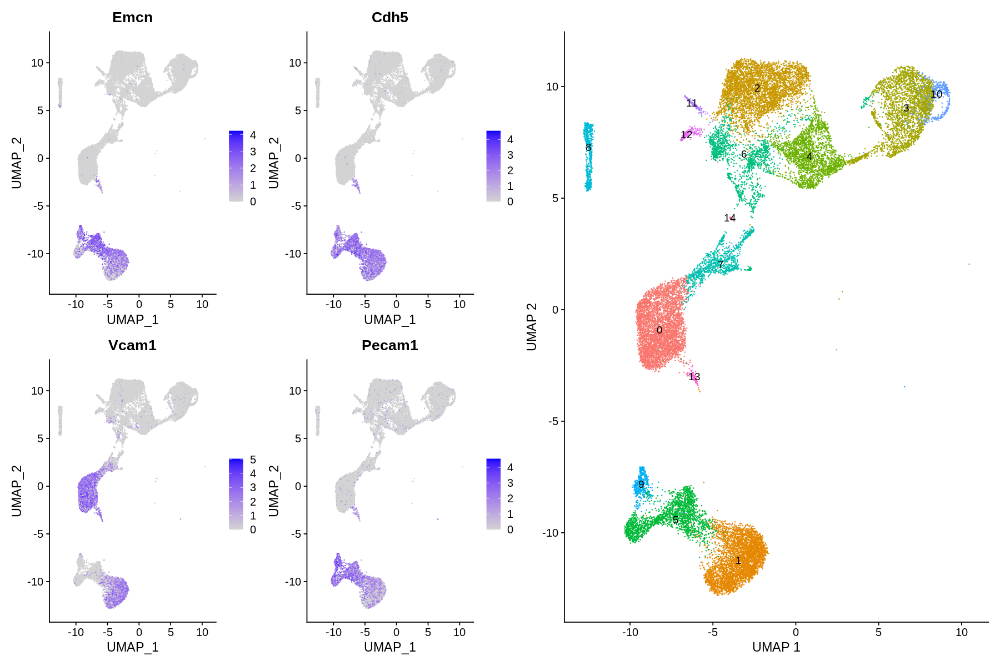

In [280]:
p1 <- FeaturePlot(bm, features = c("Emcn", "Cdh5", "Vcam1", "Pecam1"))
p2 <- DimPlot(bm, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")

p1 | p2

### Fibroblasts

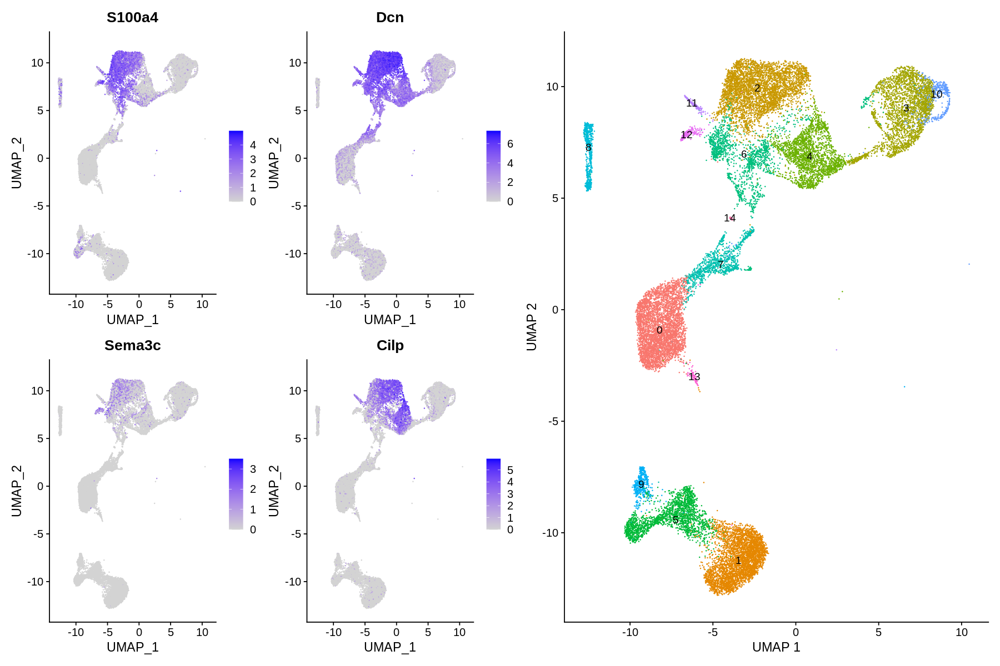

In [281]:
p1 <- FeaturePlot(bm, features = c("S100a4", "Dcn", "Sema3c", "Cilp"))
p2 <- DimPlot(bm, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")

p1 | p2

### Assigning preliminary labels

In [272]:
levels(bm)

[1] "0"  "1"  "2"  "3"  "4"  "5"  "6"  "7"  "8"  "9"  "10" "11" "12" "13" "14"

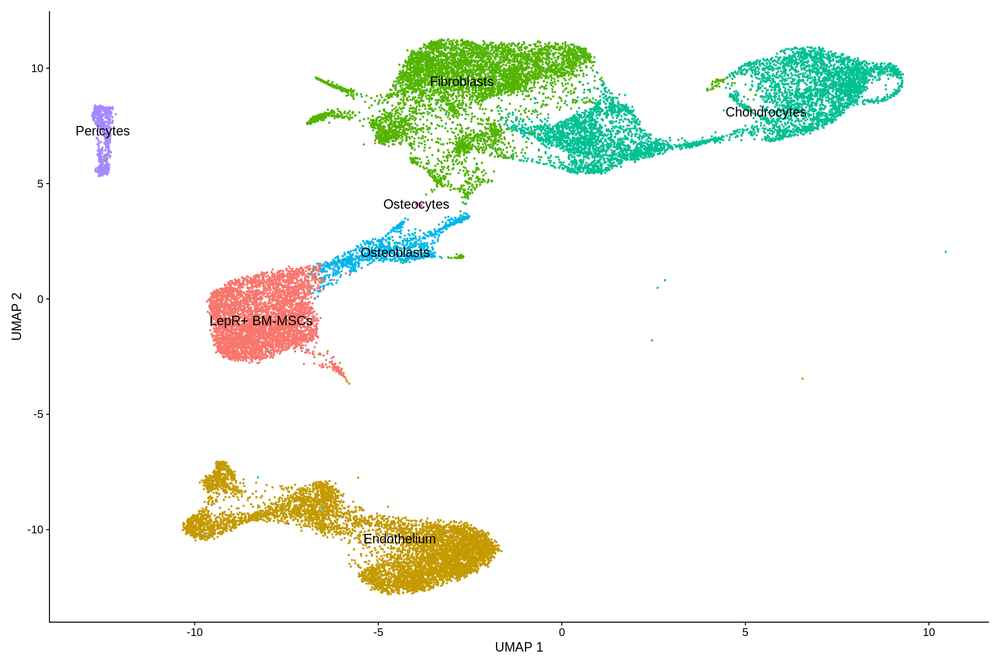

In [285]:
new.cluster.ids <- c("LepR+ BM-MSCs", "Endothelium", "Fibroblasts", 
                     "Chondrocytes", "Chondrocytes", "Endothelium",
                     "Fibroblasts", "Osteoblasts", "Pericytes", 
                     "Endothelium", "Chondrocytes", "Fibroblasts", 
                     "Fibroblasts", "LepR+ BM-MSCs", "Osteocytes")
names(new.cluster.ids) <- levels(bm)
bm <- RenameIdents(bm, new.cluster.ids)

DimPlot(bm, reduction = "umap", 
        label = TRUE, label.size = 5,
        pt.size = 0.5) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")

In [294]:
head(bm@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,seurat_clusters
,<chr>,<dbl>,<int>,<dbl>,<fct>
Std1_AAACCTGAGAAGGGTA,Standard 1,5613,2359,3.580973,4
Std1_AAACCTGAGCCAGAAC,Standard 1,3483,1598,3.043353,5
Std1_AAACCTGAGTATCGAA,Standard 1,2259,1179,6.684374,0
Std1_AAACCTGGTATAGGGC,Standard 1,2147,1149,6.334420,1
Std1_AAACCTGGTCACACGC,Standard 1,10249,2521,8.498390,3
Std1_AAACCTGGTGTGACGA,Standard 1,2644,1348,3.857791,5


In [297]:
names(new.cluster.ids) <- levels(bm@meta.data$seurat_clusters)
head(bm@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,seurat_clusters
,<chr>,<dbl>,<int>,<dbl>,<fct>
Std1_AAACCTGAGAAGGGTA,Standard 1,5613,2359,3.580973,4
Std1_AAACCTGAGCCAGAAC,Standard 1,3483,1598,3.043353,5
Std1_AAACCTGAGTATCGAA,Standard 1,2259,1179,6.684374,0
Std1_AAACCTGGTATAGGGC,Standard 1,2147,1149,6.334420,1
Std1_AAACCTGGTCACACGC,Standard 1,10249,2521,8.498390,3
Std1_AAACCTGGTGTGACGA,Standard 1,2644,1348,3.857791,5


In [304]:
bm@meta.data$CellType <- Idents(bm)
head(bm@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,seurat_clusters,CellType
,<chr>,<dbl>,<int>,<dbl>,<fct>,<fct>
Std1_AAACCTGAGAAGGGTA,Standard 1,5613,2359,3.580973,4,Chondrocytes
Std1_AAACCTGAGCCAGAAC,Standard 1,3483,1598,3.043353,5,Endothelium
Std1_AAACCTGAGTATCGAA,Standard 1,2259,1179,6.684374,0,LepR+ BM-MSCs
Std1_AAACCTGGTATAGGGC,Standard 1,2147,1149,6.334420,1,Endothelium
Std1_AAACCTGGTCACACGC,Standard 1,10249,2521,8.498390,3,Chondrocytes
Std1_AAACCTGGTGTGACGA,Standard 1,2644,1348,3.857791,5,Endothelium


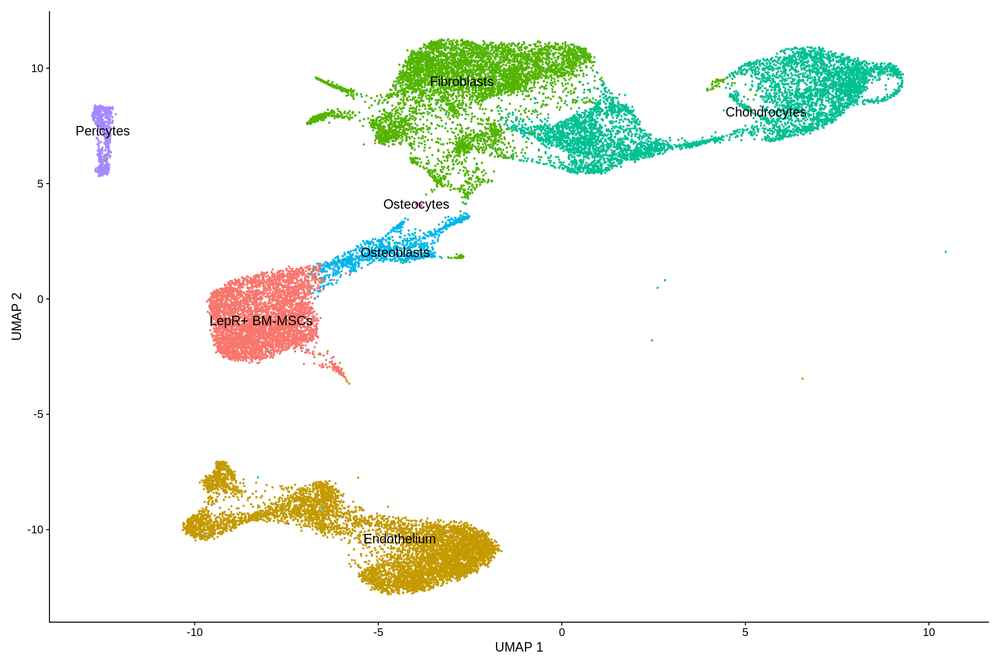

In [305]:
DimPlot(bm, reduction = "umap", group.by = "CellType", 
        label = TRUE, label.size = 5, pt.size = 0.5) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")

## Additional metadata

In [308]:
bm@meta.data$Organism <- "Mouse"
bm@meta.data$Origin <- "Adult bone"
bm@meta.data$Identity = bm@meta.data$CellType
bm@meta.data$DevTP <- "8-10w old"
bm@meta.data$Tech <- "10X"
bm@meta.data$Author <- "Beryawno"

In [313]:
metadata <- bm@meta.data
metadata$orig.ident <- NULL
metadata$nCount_RNA <- NULL
metadata$nFeature_RNA <- NULL
metadata$percent.mito <- NULL
metadata$seurat_clusters <- NULL

In [314]:
write.table(metadata, file = "metadata/metadata_Beryawno.tsv", quote = FALSE, sep = "\t")

In [310]:
saveRDS(bm, file = "RDataSessions/bonemarrow_annotated.Rds")